#**Project 3**
*IE 6400 Foundations Data Analytics Eng*

##**Group 8**

```
1.   Mahrukh Malik
2.   Sumanth Wannur
3.   Gopichand Kandikonda
```

##**Importing Libraries**

In [1]:
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
import seaborn as sns
from itertools import permutations

##**Loading Data**

In [2]:
# Loading data from the given url
url = "https://docs.google.com/spreadsheets/d/1GTwv07i98vL7S-J9eeP8NV1fJVnymm1eJ31RDyt4Mxw/export?format=csv"
data = pd.read_csv(url)

##**Cleaning Data**

The following code is performing data cleaning operations on the dataset. Specifically, it is dropping the 'Title' column since it is not required for the analysis, dropping all rows with a high number of missing values, filling all other empty cells with the string "MISSING_Keyword" to represent garbage data, as filling the empty cells with a common string allows for easier identification and handling of missing data, and resetting the index.

In [3]:
# Dropping the 'Title' column from the dataframe as it is unnecessary for keyword analysis
data = data.drop(columns='Title')

# Dropping the rows with more than 10 missing values in the remaining columns
data = data.dropna(axis=0, thresh=len(data.columns) - 10)

# Filling the remaining missing values in the keyword columns with the placeholder value "MISSING_Keyword"
data = data.fillna("MISSING_Keyword")

# Resetting the index of the dataframe after dropping and filling the columns
data = data.reset_index(drop=True)


In [4]:
data.head()

,Keyword 1,Keyword 2,Keyword 3,Keyword 4,Keyword 5,Keyword 6,Keyword 7,Keyword 8,Keyword 9,Keyword 10,Keyword 11,Keyword 12
0,EQUITY,ORGANIZATIONAL sociology,PERFORMANCE,META-analysis,PSYCHOMETRICS,ORGANIZATIONAL research,FINANCIAL performance,AGENCY theory,ORGANIZATIONAL effectiveness,ORGANIZATIONAL behavior,CORPORATE governance,MISSING_Keyword
1,DIVERSIFICATION in industry,BUSINESS planning,PERFORMANCE standards,EMPLOYEES -- Rating of,CORPORATE culture,STRATEGIC planning,ORGANIZATIONAL effectiveness,MANAGEMENT science,MANAGEMENT research,PRODUCT management,MISSING_Keyword,MISSING_Keyword
2,INTERORGANIZATIONAL relations,INTERGROUP relations,BUSINESS communication,INVESTMENTS,SUPPLY chains,KNOWLEDGE management,INTERORGANIZATIONAL networks,CORPORATE governance,GROUP decision making,INTELLECTUAL capital,MISSING_Keyword,MISSING_Keyword
3,EXECUTIVE compensation,WAGES,HUMAN capital,LABOR economics,PERSONNEL management,MANAGEMENT science,CONTINGENCY theory (Management),COMPENSATION management,EXECUTIVE ability (Management),CORPORATE governance,MISSING_Keyword,MISSING_Keyword
4,KNOWLEDGE management,INFORMATION resources management,MANAGEMENT information systems,BREAK-even analysis,DATA mining,MANAGEMENT science,RESEARCH & development,RESEARCH & development contracts,CORPORATE governance,DECISION making,ORGANIZATIONAL behavior,TRANSACTION costs


##**Extracting Keywords Data**

The below code creates a list of unique keywords from the input DataFrame by iterating through each row and column of the DataFrame and adding non-empty keywords that are not already in the list of unique keywords. By creating a list of unique keywords, the code ensures that each keyword is represented only once in the adjacency matrix, which helps to avoid redundancies and reduces the computational load for subsequent analysis. This code is repeated here for reference purposes.

In [5]:
# Extracting unique non-null keywords from multiple columns in a pandas dataframe
unique_keywords_df = pd.melt(data, value_vars=[f"Keyword {i}" for i in range(1, 13)])
unique_keywords = unique_keywords_df['value'].dropna().unique().tolist()

# Removing the placeholder value from the list of unique keywords
unique_keywords.remove('MISSING_Keyword')

# Printing the list of unique keywords
print(unique_keywords)


['EQUITY', 'DIVERSIFICATION in industry', 'INTERORGANIZATIONAL relations', 'EXECUTIVE compensation', 'KNOWLEDGE management', 'EMOTIONS (Psychology)', 'SUPERVISORS', 'INDUSTRIAL relations', 'DECISION making', 'CORPORATE governance', 'EXECUTIVES', 'FAMILY-owned business enterprises', 'INSTITUTIONAL investors', 'RESEARCH & development', 'PROPERTY', 'STOCK options', 'MANAGEMENT science', 'AGGRESSION (Psychology)', 'CHIEF executive officers', 'MENTAL fatigue', 'PERSONNEL management', 'PRODUCT management', 'SOCIAL capital (Sociology)', 'ORGANIZATIONAL behavior', 'NEW products', 'LEADERSHIP', 'TEAMS in the workplace', 'LABOR supply', 'EMPLOYEES -- Attitudes', 'WORK & family', 'HUMAN capital', 'SOCIAL status', 'EMPLOYEE motivation', 'ORGANIZATIONAL change', 'CREATIVE ability', 'GOING public (Securities)', 'INTERNATIONAL business enterprises -- Management', 'COMPENSATION management', 'CROSS-functional teams', 'SERVICE industries -- Management', 'ORGANIZATIONAL sociology', 'BUSINESS planning', '

In [6]:
len(unique_keywords)

248

##**Creating Adjacency Matrix**

###**Initializing Adjacency Matrix**

Below code creates an empty DataFrame with all values set to zero, with the row and column names set to the unique keywords. 

In [7]:
# Creating a dataframe for the adjacency matrix
adj_matrix = pd.DataFrame(0, columns=unique_keywords, index=unique_keywords, dtype=int)

In [8]:
adj_matrix

,EQUITY,DIVERSIFICATION in industry,INTERORGANIZATIONAL relations,EXECUTIVE compensation,KNOWLEDGE management,EMOTIONS (Psychology),SUPERVISORS,INDUSTRIAL relations,DECISION making,CORPORATE governance,...,PROBLEM employees,STRATEGIC business units,SUBSIDIARY corporations -- Management,FINANCIAL management,CUSTOMER orientation,TRANSACTION costs,INNOVATION adoption,WORK attitudes,HOST countries (Business),MARKETING strategy
EQUITY,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
DIVERSIFICATION in industry,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
INTERORGANIZATIONAL relations,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
EXECUTIVE compensation,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
KNOWLEDGE management,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TRANSACTION costs,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
INNOVATION adoption,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
WORK attitudes,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
HOST countries (Business),0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


###**Filling the Adjacency Matrix**

Below code fills the DataFrame by iterating through each row of the input DataFrame and finding all combinations of keywords in that row. For each pair of non-empty keywords, it increments the corresponding cell in the adjacency matrix by 1.

In [9]:
# Filling the adjacency matrix
for _, row in data.iterrows():
    for a, b in permutations(row, 2):
        if a != 'MISSING_Keyword' and b != 'MISSING_Keyword':
            adj_matrix.at[a, b] += 1

In [10]:
adj_matrix

,EQUITY,DIVERSIFICATION in industry,INTERORGANIZATIONAL relations,EXECUTIVE compensation,KNOWLEDGE management,EMOTIONS (Psychology),SUPERVISORS,INDUSTRIAL relations,DECISION making,CORPORATE governance,...,PROBLEM employees,STRATEGIC business units,SUBSIDIARY corporations -- Management,FINANCIAL management,CUSTOMER orientation,TRANSACTION costs,INNOVATION adoption,WORK attitudes,HOST countries (Business),MARKETING strategy
EQUITY,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
DIVERSIFICATION in industry,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0
INTERORGANIZATIONAL relations,0,0,0,0,1,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
EXECUTIVE compensation,0,0,0,0,0,0,0,0,2,2,...,0,0,0,0,0,0,0,0,0,0
KNOWLEDGE management,0,0,1,0,0,0,0,0,1,2,...,0,0,0,0,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TRANSACTION costs,0,0,0,0,1,0,0,0,1,1,...,0,0,0,0,0,0,0,0,0,0
INNOVATION adoption,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
WORK attitudes,0,0,0,0,0,0,0,1,0,0,...,1,0,0,0,0,0,0,0,0,0
HOST countries (Business),0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0


In [11]:
# Calculating the sum of each row in the adjacency matrix to check the total number of 1's
row_sums = pd.DataFrame(adj_matrix.iloc[:, :247].sum(axis=1), columns=['Sum'])

# Printing the resulting dataframe
row_sums


,Sum
EQUITY,10
DIVERSIFICATION in industry,20
INTERORGANIZATIONAL relations,27
EXECUTIVE compensation,36
KNOWLEDGE management,20
...,...
TRANSACTION costs,11
INNOVATION adoption,11
WORK attitudes,11
HOST countries (Business),11


##**Converting Adjacency Matrix Into a Network**

We have converted the adjacency matrix adj_matrix to a network object using the from_pandas_adjacency() method of the networkx library. In the resulting graph object N_Graph each node represents a unique keyword, and each edge between two nodes represents a co-occurrence between those keywords. The weight of each edge is equal to the number of times the two keywords co-occur in the dataset.

In [12]:
# Converting adjacency matrix to a network
N_Graph = nx.from_pandas_adjacency(adj_matrix)
# Printing the graph
print(N_Graph)

Graph with 248 nodes and 2141 edges


##**Retrieving Edge Weights**

In [13]:
# Retrieving edge weights
edge_weights = nx.get_edge_attributes(N_Graph, 'weight')

##**Plotting Weighted Network Plot**
In the below code, we have created a network graph visualization of N_Graph using the Kamada-Kawai layout. This layout algorithm tries to minimize the energy of the graph by modeling it as a system of springs and masses, which results in a visually pleasing layout of the nodes.

In [14]:
# Setting up Kamada-Kawai layout
pos = nx.kamada_kawai_layout(N_Graph)
# Setting edge widths based on edge weights
edge_widths = [2 * edge_weights[edge] for edge in N_Graph.edges()]

# Generating a plot
plt.figure(figsize=(80, 80))
node_mapping = dict(zip(N_Graph, adj_matrix.columns)) 
N_Graph = nx.relabel_nodes(N_Graph, node_mapping)
nx.draw(N_Graph, pos=pos, with_labels=True, font_weight='bold', node_color='skyblue', edge_color='gray', width=edge_widths)

# Displaying the plot
plt.show()

##**Calculating Node Degree and Strength**

In [17]:
# Computing degree and strength
node_degree = pd.DataFrame(list(N_Graph.degree()), columns=['Keyword', 'Degree'])
node_strength = pd.DataFrame(list(N_Graph.degree(weight='weight')), columns=['Keyword', 'Strength'])

In [18]:
node_degree

,Keyword,Degree
0,EQUITY,10
1,DIVERSIFICATION in industry,18
2,INTERORGANIZATIONAL relations,24
3,EXECUTIVE compensation,31
4,KNOWLEDGE management,19
...,...,...
243,TRANSACTION costs,11
244,INNOVATION adoption,11
245,WORK attitudes,11
246,HOST countries (Business),11


In [19]:
node_strength

,Keyword,Strength
0,EQUITY,10
1,DIVERSIFICATION in industry,20
2,INTERORGANIZATIONAL relations,27
3,EXECUTIVE compensation,36
4,KNOWLEDGE management,20
...,...,...
243,TRANSACTION costs,11
244,INNOVATION adoption,11
245,WORK attitudes,11
246,HOST countries (Business),11


##**Top 10 Nodes by Degree and Strength**

In [25]:
# Sorting top 10 nodes by degree and strength
top_degree = node_degree.sort_values(by='Degree', ascending=False)[:10]
top_strength = node_strength.sort_values(by='Strength', ascending=False)[:10]


In [26]:
top_degree

,Keyword,Degree
23,ORGANIZATIONAL behavior,166
112,ORGANIZATIONAL effectiveness,104
16,MANAGEMENT science,102
20,PERSONNEL management,93
8,DECISION making,90
156,ORGANIZATIONAL structure,74
40,ORGANIZATIONAL sociology,66
88,STRATEGIC planning,66
47,INDUSTRIAL management,64
9,CORPORATE governance,62


In [27]:
top_strength

,Keyword,Strength
23,ORGANIZATIONAL behavior,265
112,ORGANIZATIONAL effectiveness,144
16,MANAGEMENT science,136
20,PERSONNEL management,126
8,DECISION making,112
156,ORGANIZATIONAL structure,107
40,ORGANIZATIONAL sociology,96
9,CORPORATE governance,85
47,INDUSTRIAL management,84
88,STRATEGIC planning,80


##**Top 10 by Weight**

In the below code, we are generating a graph representation of a set of keywords and their relationships, and then extracting the top 10 most important relationships from the graph.
We are using permutations instead of combinations because we want to capture all possible relationships between the keywords in the input set, regardless of their order. Using permutations is important for capturing all possible relationships between the keywords and creating a complete and symmetrical graph, which are both essential for accurate analysis of the keyword network.

Please note that the code is sorting the node pairs by weight. If there are multiple pairs with the same weight, they will be sorted based on their order in the adjacency matrix.

In [28]:
# Generating all possible keyword pairs using permutations
keyword_pairs = list(permutations(unique_keywords, 2))

# Filling the adjacency matrix with counts from the keyword pairs
for keyword_pair in keyword_pairs:
    a, b = keyword_pair
    count = adj_matrix.at[a, b]
    N_Graph.add_edge(a, b, weight=count)

# Sorting the top 10 node pairs by weight
edge_weights = [(u, v, w) for u, v, w in N_Graph.edges(data='weight')]
top_edge_weights_list = sorted(edge_weights, key=lambda x: x[2], reverse=True)[:10]

top_edge_weights = pd.DataFrame(top_edge_weights_list, columns=['keyword 1', 'keyword 2', 'Weight'])


In [29]:
top_edge_weights

,keyword 1,keyword 2,Weight
0,ORGANIZATIONAL behavior,ORGANIZATIONAL effectiveness,11
1,ORGANIZATIONAL behavior,ORGANIZATIONAL structure,9
2,PERSONNEL management,ORGANIZATIONAL behavior,8
3,MANAGEMENT science,ORGANIZATIONAL behavior,7
4,DECISION making,ORGANIZATIONAL behavior,6
5,CORPORATE governance,ORGANIZATIONAL behavior,6
6,ORGANIZATIONAL behavior,ORGANIZATIONAL sociology,6
7,ORGANIZATIONAL effectiveness,ORGANIZATIONAL structure,6
8,INDUSTRIAL relations,ORGANIZATIONAL behavior,5
9,ORGANIZATIONAL behavior,ORGANIZATIONAL change,5


##**Plotting Average Strength vs Degree**

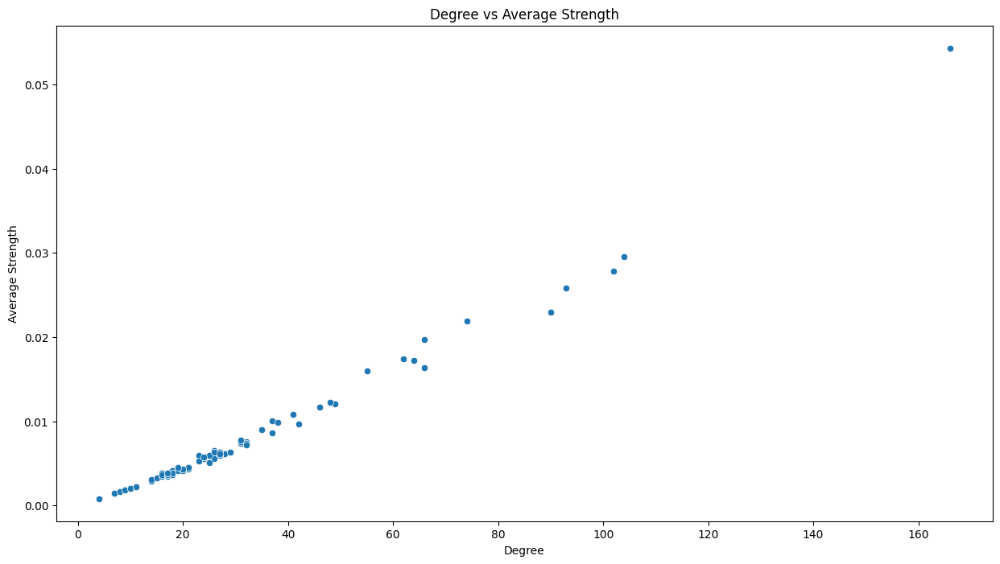

In [30]:
# Computing average strength
total_strength = node_strength['Strength'].sum()
node_strength['Avg_Strength'] = node_strength['Strength'] / total_strength

# Merging dataframes
merged_df = pd.merge(node_degree, node_strength, on='Keyword')

# Plotting average strength vs degree
plt.figure(figsize=(15, 8))
sns.scatterplot(x='Degree', y='Avg_Strength', data=merged_df)
plt.xlabel("Degree")
plt.ylabel("Average Strength")
plt.title("Degree vs Average Strength")
plt.show()
